In [38]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats

In [2]:


# Importation de la donnée
df = pd.read_csv("../Data/train.csv")

# Affichage des 10 premières entrées
df.head(10)

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000
5,6,50,RL,85.0,14115,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,MnPrv,Shed,700,10,2009,WD,Normal,143000
6,7,20,RL,75.0,10084,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,8,2007,WD,Normal,307000
7,8,60,RL,NaN,10382,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,Shed,350,11,2009,WD,Normal,200000
8,9,50,RM,51.0,6120,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,4,2008,WD,Abnorml,129900
9,10,190,RL,50.0,7420,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,1,2008,WD,Normal,118000


In [3]:
df.info()
nbRow = df.count()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

In [4]:
# Drop colonnes avec plus de 30% de données manquantes
for x in df.columns :
    if df[x].isna().sum() > nbRow[x] * 0.3 :
        df = df.drop(x, axis=1)

count      1460.000000
mean     180921.195890
std       79442.502883
min       34900.000000
25%      129975.000000
50%      163000.000000
75%      214000.000000
max      755000.000000
Name: SalePrice, dtype: float64
Le plupart des maisons ont un prix situer entre 100 000 et 300 000 $


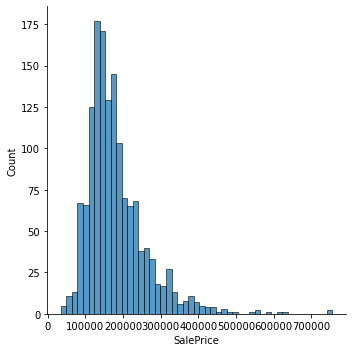

In [5]:
print(df.SalePrice.describe())
salePriceDisplot = sns.displot(df.SalePrice)
print("Le plupart des maisons ont un prix situer entre 100 000 et 300 000 $")

int64
int64
object
float64
int64
object
object
object
object
object
object
object
object
object
object
object
int64
int64
int64
int64
object
object
object
object
object
float64
object
object
object
object
object
object
object
int64
object
int64
int64
int64
object
object
object
object
int64
int64
int64
int64
int64
int64
int64
int64
int64
int64
object
int64
object
int64
object
float64
object
int64
int64
object
object
object
int64
int64
int64
int64
int64
int64
int64
int64
int64
object
object
int64
Les valeurs qui semblent en corrélation avec SalePrice sont :
 - GarageCars
 - GarageArea
 - TotRmsAbvGrd
 - 1stFlrSF
 - TotalBsmtSF
 - LotFrontage


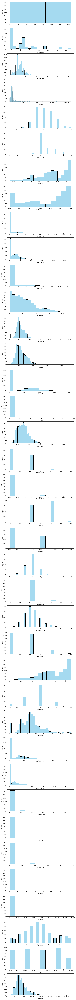

In [50]:
# Histogramme des valeurs numérique
columnIntFloat = []
for x in df.columns :
    if df[x].dtype == np.float64 or df[x].dtype == np.int64 :
        columnIntFloat.append(x)

fig, axs = plt.subplots(len(columnIntFloat), 1, figsize=(10,150))
for i, x in enumerate(columnIntFloat):
    sns.histplot(df[x] , color="skyblue", ax=axs[i])

print("""Les valeurs qui semblent en corrélation avec SalePrice sont :
 - GarageCars
 - GarageArea
 - TotRmsAbvGrd
 - 1stFlrSF
 - TotalBsmtSF
 - LotFrontage""")

In [7]:
correlationDict = {}
for x in columnIntFloat :
    if x != "SalePrice" :
        correlationDict[x] = df.SalePrice.corr(df[x])

sortedValue = sorted(correlationDict.items(), key=lambda x:x[1])
top10 = sortedValue[-10:]
for x in top10 :
    print(x[0], ' : ', x[1])

YearRemodAdd  :  0.5071009671113864
YearBuilt  :  0.5228973328794969
TotRmsAbvGrd  :  0.5337231555820284
FullBath  :  0.5606637627484456
1stFlrSF  :  0.6058521846919147
TotalBsmtSF  :  0.6135805515591956
GarageArea  :  0.6234314389183617
GarageCars  :  0.6404091972583531
GrLivArea  :  0.7086244776126522
OverallQual  :  0.7909816005838048


Les plots s'éléve de plus en plus


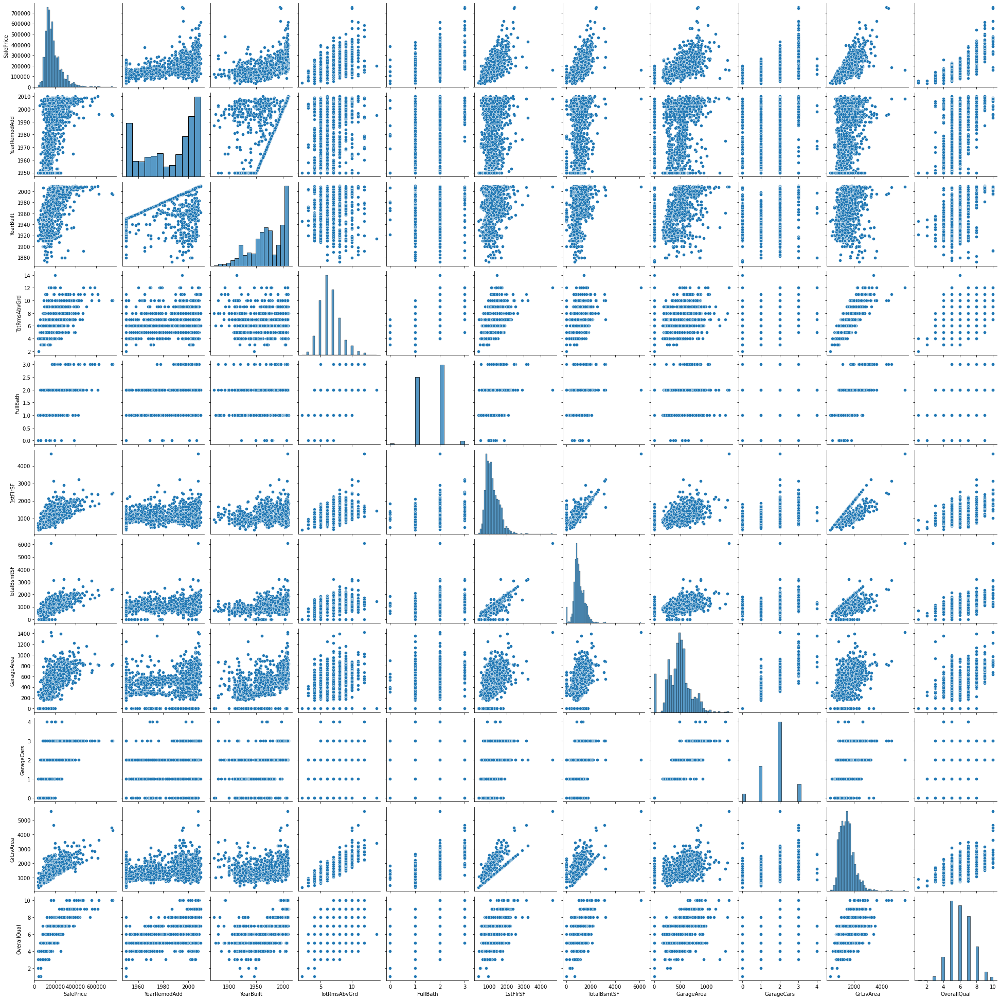

In [8]:
top10PairPlot = ["SalePrice"]
for x in top10 :
    top10PairPlot.append(x[0])
dfTop10 = df[top10PairPlot]
sns.pairplot(dfTop10)

print("Les plots s'éléve de plus en plus")

3 lien me paraisse assez fort :
years built - FirePlaces
KitchenAbvGr - Live Area
YrSold - OverallQual


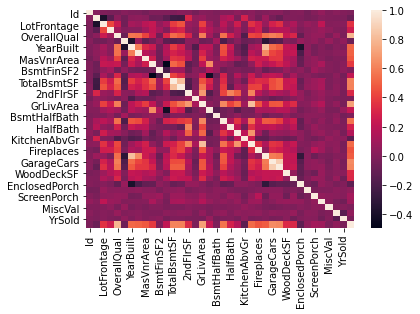

In [21]:
corrAll = df[columnIntFloat].corr()
sns.heatmap(corrAll)
print("""3 lien me paraisse assez fort :
years built - FirePlaces
KitchenAbvGr - Live Area
YrSold - OverallQual""")

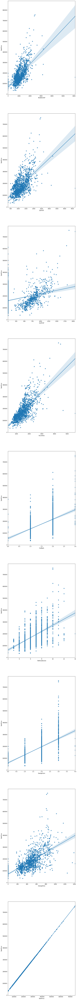

In [31]:
selectColumns = ['TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'GrLivArea', 'FullBath', 'TotRmsAbvGrd', 'GarageCars', 'GarageArea', 'SalePrice'] 

# sns.regplot(x='TotalBsmtSF', y='SalePrice', data=df[selectColumns])

fig, axs = plt.subplots(len(selectColumns), 1, figsize=(10,150))
for i, x in enumerate(selectColumns):
    sns.regplot(x=x, y='SalePrice', data=df[selectColumns], ax=axs[i])

<ipython-input-48-e9075cbaaea2>:6: UserWarning: Legend does not support [<matplotlib.lines.Line2D object at 0x7fa51b916730>] instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
  graph.ax_joint.legend([phantom], ['r={:f}, p={:f}'.format(r,p)])


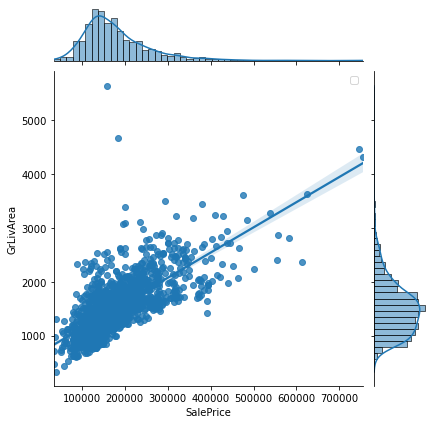

In [48]:
dfJointPlot = df[['SalePrice', 'GrLivArea']]

graph = sns.jointplot(data=dfJointPlot, x=dfJointPlot["SalePrice"], y=dfJointPlot["GrLivArea"], kind="reg")
r, p = stats.pearsonr(dfJointPlot["SalePrice"], dfJointPlot["GrLivArea"])
phantom = graph.ax_joint.plot([],[], linestyle="", alpha=0)
graph.ax_joint.legend([phantom], ['r={:f}, p={:f}'.format(r,p)])

In [52]:
# Fonction qui retourne les colonnes contenant des objets
def getObject(df) :
    valret = []
    for x in df.columns :
        if df[x].dtype == "object" : 
            valret.append(x)
    return valret

objectList = getObject(df)

/home/apprenant/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/apprenant/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/apprenant/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn

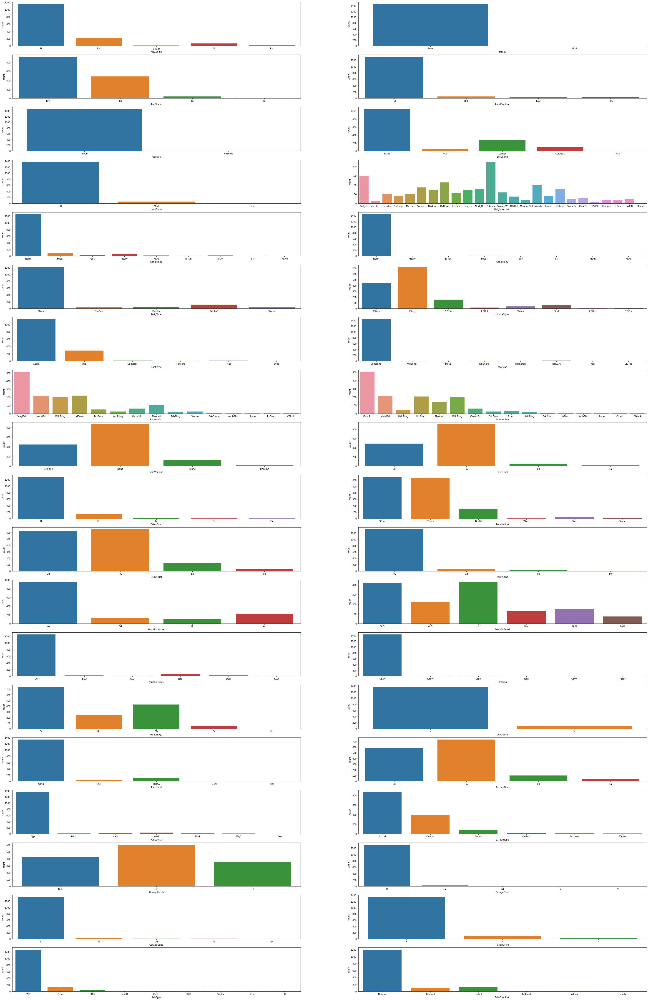

In [80]:
fig, axs = plt.subplots(int(len(objectList) / 2), 2, figsize=(50,80))
for i, x in enumerate(objectList):
    sns.countplot(df[x], ax=axs[int(i/2), int(i%2)])

In [ ]:
print("""Je pense que les 5 variable qui agissent le moins sur le prix sont : 
- RoofStyle     Le style dépend surtout de la situtation climatique de la région
- Foundation    Pas d'intérêt visible
- Street        Pas d'intérêt visible
- SaleType      Pas d'intérêt visible
- PavedDrive    Pas d'intérêt visible""")